In [45]:
# Initial imports
import os
import pandas as pd
from dotenv import load_dotenv
load_dotenv()
from newsapi import NewsApiClient
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
analyzer = SentimentIntensityAnalyzer()


%matplotlib inline

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [46]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [47]:
# Read your api key environment variable
api_key = "c8a1e7eaa0f6412fba00fd964c1ce000"

In [48]:
# Create a newsapi client
newsapi = NewsApiClient(api_key=api_key)

In [49]:
# Fetch the Bitcoin news articles
btc_headlines = newsapi.get_everything(q="bitcoin", language="en", page_size=100,sort_by="relevancy")
btc_articles = btc_headlines["articles"]
btc_articles[0]

{'source': {'id': 'wired', 'name': 'Wired'},
 'author': 'Joel Khalili',
 'title': 'The Science of Crypto Forensics Survives a Court Battle—for Now',
 'description': 'A jury convicted Roman Sterlingov of money laundering this month. His defense team says it will appeal, saying the crypto-tracing technique at the heart of the case is “pseudoscience.”',
 'url': 'https://www.wired.com/story/the-science-of-crypto-forensics-court-battle/',
 'urlToImage': 'https://media.wired.com/photos/6603759fd3a75d0aa76d16ab/191:100/w_1280,c_limit/business_crypto_tracing_forensics_trial.jpg',
 'publishedAt': '2024-03-27T11:00:00Z',
 'content': 'On March 12, Russian-Swedish national Roman Sterlingov was found guilty of money laundering conspiracy and other violations by a federal jury in Washington, DC, for having operated Bitcoin Fog, a ser… [+3654 chars]'}

In [50]:
# Fetch the Ethereum news articles
eth_headlines = newsapi.get_everything(q="ethereum", language="en", page_size=100,sort_by="relevancy")
eth_articles = eth_headlines["articles"]
eth_articles[0]

{'source': {'id': None, 'name': 'Gizmodo.com'},
 'author': 'Matt Novak',
 'title': 'The Feds Are Reportedly Investigating Ethereum Foundation',
 'description': 'The U.S. Securities and Exchange Commission (SEC) is investigating the Ethereum Foundation and companies doing business with the nonprofit, according to a new report from Fortune Wednesday. And that’s very bad news for crypto enthusiasts who were hopeful that…',
 'url': 'https://gizmodo.com/sec-ethereum-price-bitcoin-investigation-crypto-etf-1851352576',
 'urlToImage': 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/b5adaa02e058acea54ab69fa505844cc.jpg',
 'publishedAt': '2024-03-20T18:15:00Z',
 'content': 'The U.S. Securities and Exchange Commission (SEC) is investigating the Ethereum Foundation and companies doing business with the nonprofit, according to a new report from Fortune Wednesday. And thats… [+2397 chars]'}

In [51]:
# Create the Bitcoin sentiment scores DataFrame
btc_sentiments = []

for article in btc_articles:
    try:
        text = article["content"]
        date = article["publishedAt"][:10]
        sentiment = analyzer.polarity_scores(text)
        compound = sentiment["compound"]
        pos = sentiment["pos"]
        neu = sentiment["neu"]
        neg = sentiment["neg"]
        
        btc_sentiments.append({
            "text": text,
            "date": date,
            "compound": compound,
            "positive": pos,
            "negative": neg,
            "neutral": neu
            
        })
        
    except AttributeError:
        pass
    
# Create DataFrame
btc_df = pd.DataFrame(btc_sentiments)

# Reorder DataFrame columns
cols = ["date", "text", "compound", "positive", "negative", "neutral"]
btc_df = btc_df[cols]

In [52]:
# Drop duplicates articles
btc_df.drop_duplicates(keep="first", inplace=True)
btc_df.head()

,date,text,compound,positive,negative,neutral
0,2024-03-27,"On March 12, Russian-Swedish national Roman St...",-0.8625,0.000,0.255,0.745
1,2024-03-20,A former takeaway worker found with Bitcoin wo...,-0.3818,0.049,0.091,0.859
2,2024-04-17,"The Grayscale Bitcoin Trust (GBTC), a prominen...",0.7506,0.222,0.000,0.778
3,2024-03-20,The U.S. Securities and Exchange Commission (S...,0.2960,0.071,0.000,0.929
4,2024-03-19,Japan’s Government Pension Investment Fund (GP...,0.0000,0.000,0.000,1.000


In [53]:
# Create the ethereum sentiment scores DataFrame
eth_sentiments = []

for article in eth_articles:
    try:
        text = article["content"]
        date = article["publishedAt"][:10]
        sentiment = analyzer.polarity_scores(text)
        compound = sentiment["compound"]
        pos = sentiment["pos"]
        neu = sentiment["neu"]
        neg = sentiment["neg"]
        
        eth_sentiments.append({
            "text": text,
            "date": date,
            "compound": compound,
            "positive": pos,
            "negative": neg,
            "neutral": neu
            
        })
        
    except AttributeError:
        pass
    
# Create DataFrame
eth_df = pd.DataFrame(eth_sentiments)

# Reorder DataFrame columns
cols = ["date", "text", "compound", "positive", "negative", "neutral"]
eth_df = eth_df[cols]

In [54]:
# Drop duplicates articles
eth_df.drop_duplicates(keep="first", inplace=True)
eth_df.head()

,date,text,compound,positive,negative,neutral
0,2024-03-20,The U.S. Securities and Exchange Commission (S...,0.2960,0.071,0.000,0.929
1,2024-03-22,Early Ethereum (ETH) advisor Steven Nerayoff h...,0.2263,0.068,0.040,0.892
2,2024-03-21,Solana has surpassed Ethereum to get to the nu...,0.0772,0.038,0.000,0.962
3,2024-04-04,The U.S. Securities and Exchange Commission (S...,0.2960,0.073,0.000,0.927
4,2024-04-10,VanEck CEO Jan van Eck has voiced his skeptici...,0.5106,0.142,0.054,0.804


In [55]:
# Describe the Bitcoin Sentiment
btc_df.describe()

,compound,positive,negative,neutral
count,100.000000,100.000000,100.00000,100.000000
mean,0.155107,0.084230,0.04567,0.870070
std,0.449244,0.074595,0.07498,0.090471
min,-0.908100,0.000000,0.00000,0.593000
25%,-0.006450,0.000000,0.00000,0.811500
50%,0.214300,0.076000,0.00000,0.874500
75%,0.518525,0.131000,0.07300,0.932500
max,0.784500,0.355000,0.32600,1.000000


In [56]:
# Describe the Ethereum Sentiment
eth_df.describe()

,compound,positive,negative,neutral
count,100.000000,100.000000,100.000000,100.000000
mean,0.206946,0.089860,0.033200,0.876950
std,0.401568,0.079523,0.059544,0.090409
min,-0.904200,0.000000,0.000000,0.590000
25%,0.000000,0.000000,0.000000,0.811250
50%,0.214300,0.076500,0.000000,0.894000
75%,0.514625,0.135250,0.059750,0.940250
max,0.895700,0.410000,0.289000,1.000000


---

In [57]:
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, PorterStemmer
from string import punctuation
import regex
import re

In [58]:
btc_text_df = btc_df['text'].astype('string')
btc_text_df

0     On March 12, Russian-Swedish national Roman St...
1     A former takeaway worker found with Bitcoin wo...
2     The Grayscale Bitcoin Trust (GBTC), a prominen...
3     The U.S. Securities and Exchange Commission (S...
4     Japan’s Government Pension Investment Fund (GP...
                            ...                        
95    The Rhysida ransomware group claims it was res...
96    In the run-up to the fourth bitcoin halving on...
97    BitcoinBTC
 has fallen sharply after Israel's...
98    Monday (Apr. 15) was an eventful day for stock...
99    HodlX Guest Post Submit Your Post
Bitcoin min...
Name: text, Length: 100, dtype: string

In [59]:
eth_text_df = eth_df['text'].astype('string')
eth_text_df

0     The U.S. Securities and Exchange Commission (S...
1     Early Ethereum (ETH) advisor Steven Nerayoff h...
2     Solana has surpassed Ethereum to get to the nu...
3     The U.S. Securities and Exchange Commission (S...
4     VanEck CEO Jan van Eck has voiced his skeptici...
                            ...                        
95    In crypto news today BlackRock CEO Larry Fink ...
96    With BlackRock launching its first tokenized f...
97    In a recent deep dive into Ethereums future sc...
98    In crypto news today Bitcoin makes history and...
99    Crypto Price Prediction: The Easter holiday tr...
Name: text, Length: 100, dtype: string

In [60]:
# Complete the tokenizer function
def tokenizer(text):

    """Tokenizes text."""

    # Create a list of the words
    words = [word_tokenize(sentence) for sentence in text]

    # Remove punctuation using regex; Remove any non-string character and replace with empty space
    regex = re.compile("[^a-zA-Z ]")
    re_clean = regex.sub('', text)
    words_clean = word_tokenize(re_clean)
   
   # Remove the stop words
    sw = set(stopwords.words('english'))
    first_pass = [word for word in words_clean if word not in sw]

    # Define additional stopwords
    sw_addon = {'char', 'chars' 'la', 'im','volod', 'drin', 'wa', 'ha'}
    second_pass = [word.lower() for word in words_clean if word.lower() not in sw.union(sw_addon)] 

    # Lemmatize Words into root words; convert the words to lowercase
    lemmatizer = WordNetLemmatizer()
    lem = [lemmatizer.lemmatize(word) for word in words_clean]
    tokens = [word.lower() for word in lem if word.lower() not in sw.union(sw_addon)] 
  
    return tokens

In [61]:
# Tokenizing article in the first row of the "text" column
tokenizer(btc_text_df[0])

['march',
 'russianswedish',
 'national',
 'roman',
 'sterlingov',
 'found',
 'guilty',
 'money',
 'laundering',
 'conspiracy',
 'violation',
 'federal',
 'jury',
 'washington',
 'dc',
 'operated',
 'bitcoin',
 'fog',
 'ser']

In [62]:
# Create for-loop to iterate through rows in the "text" column 
btc_tokens = []
for row in btc_text_df:
    token = tokenizer(row)
    btc_tokens.append(token)

    print(btc_tokens) 

[['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering', 'conspiracy', 'violation', 'federal', 'jury', 'washington', 'dc', 'operated', 'bitcoin', 'fog', 'ser']]
[['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering', 'conspiracy', 'violation', 'federal', 'jury', 'washington', 'dc', 'operated', 'bitcoin', 'fog', 'ser'], ['former', 'takeaway', 'worker', 'found', 'bitcoin', 'worth', 'bn', 'convicted', 'southwark', 'crown', 'court', 'crime', 'linked', 'money', 'launderingjian', 'wen', 'hendon', 'north', 'london', 'inv']]
[['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering', 'conspiracy', 'violation', 'federal', 'jury', 'washington', 'dc', 'operated', 'bitcoin', 'fog', 'ser'], ['former', 'takeaway', 'worker', 'found', 'bitcoin', 'worth', 'bn', 'convicted', 'southwark', 'crown', 'court', 'crime', 'linked', 'money', 'launderingjian', 'wen', 'he

In [63]:
# Create a new tokens column for bitcoin
btc_df['btc_token'] = btc_tokens
btc_df.head()

,date,text,compound,positive,negative,neutral,btc_token
0,2024-03-27,"On March 12, Russian-Swedish national Roman St...",-0.8625,0.000,0.255,0.745,"[march, russianswedish, national, roman, sterl..."
1,2024-03-20,A former takeaway worker found with Bitcoin wo...,-0.3818,0.049,0.091,0.859,"[former, takeaway, worker, found, bitcoin, wor..."
2,2024-04-17,"The Grayscale Bitcoin Trust (GBTC), a prominen...",0.7506,0.222,0.000,0.778,"[grayscale, bitcoin, trust, gbtc, prominent, b..."
3,2024-03-20,The U.S. Securities and Exchange Commission (S...,0.2960,0.071,0.000,0.929,"[us, securities, exchange, commission, sec, in..."
4,2024-03-19,Japan’s Government Pension Investment Fund (GP...,0.0000,0.000,0.000,1.000,"[japans, government, pension, investment, fund..."


In [64]:
eth_tokens = []
for row in eth_text_df:
    token = tokenizer(row)
    eth_tokens.append(token)

    print(eth_tokens) 

[['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company', 'business', 'nonprofit', 'according', 'new', 'report', 'fortune', 'wednesday', 'thats']]
[['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company', 'business', 'nonprofit', 'according', 'new', 'report', 'fortune', 'wednesday', 'thats'], ['early', 'ethereum', 'eth', 'advisor', 'steven', 'nerayoff', 'recently', 'expressed', 'serious', 'concern', 'investigation', 'ethereum', 'us', 'securities', 'exchange', 'commission', 'secnerayoff', 'claimed', 'anx']]
[['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company', 'business', 'nonprofit', 'according', 'new', 'report', 'fortune', 'wednesday', 'thats'], ['early', 'ethereum', 'eth', 'advisor', 'steven', 'nerayoff', 'recently', 'expressed', 'serious', 'concern', 'investigation', 'ethereum', 'us', 'securities', 'exchange', 'commission', 'sec

In [65]:
# Create a new tokens column for ethereum
eth_df['eth_token'] = eth_tokens
eth_df.head()

,date,text,compound,positive,negative,neutral,eth_token
0,2024-03-20,The U.S. Securities and Exchange Commission (S...,0.2960,0.071,0.000,0.929,"[us, securities, exchange, commission, sec, in..."
1,2024-03-22,Early Ethereum (ETH) advisor Steven Nerayoff h...,0.2263,0.068,0.040,0.892,"[early, ethereum, eth, advisor, steven, nerayo..."
2,2024-03-21,Solana has surpassed Ethereum to get to the nu...,0.0772,0.038,0.000,0.962,"[solana, surpassed, ethereum, get, number, one..."
3,2024-04-04,The U.S. Securities and Exchange Commission (S...,0.2960,0.073,0.000,0.927,"[us, securities, exchange, commission, sec, in..."
4,2024-04-10,VanEck CEO Jan van Eck has voiced his skeptici...,0.5106,0.142,0.054,0.804,"[vaneck, ceo, jan, van, eck, voiced, skepticis..."


---

# NGrams and Frequency Analysis

In this section you will look at the ngrams and word frequency for each coin. 

1. Use NLTK to produce the n-grams for N = 2. 
2. List the top 10 words for each coin. 

In [66]:
from collections import Counter
from nltk import ngrams

In [67]:
# Create one list of tokens from list of tokens in each row
btc_processed = []
for row in btc_df['btc_token']:
    for item in row:
        btc_processed.append(item)
        print(btc_processed)

['march']
['march', 'russianswedish']
['march', 'russianswedish', 'national']
['march', 'russianswedish', 'national', 'roman']
['march', 'russianswedish', 'national', 'roman', 'sterlingov']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering', 'conspiracy']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering', 'conspiracy', 'violation']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'found', 'guilty', 'money', 'laundering', 'conspiracy', 'violation', 'federal']
['march', 'russianswedish', 'national', 'roman', 'sterlingov', 'fo

In [68]:
eth_processed = []
for row in eth_df['eth_token']:
    for item in row:
        eth_processed.append(item)
        print(eth_processed)

['us']
['us', 'securities']
['us', 'securities', 'exchange']
['us', 'securities', 'exchange', 'commission']
['us', 'securities', 'exchange', 'commission', 'sec']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company', 'business']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company', 'business', 'nonprofit']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum', 'foundation', 'company', 'business', 'nonprofit', 'according']
['us', 'securities', 'exchange', 'commission', 'sec', 'investigating', 'ethereum

In [69]:
# Generate the Bitcoin N-grams where N=2
btc_bigram = Counter(ngrams(btc_processed, n=2))
print(dict(btc_bigram))


{('march', 'russianswedish'): 1, ('russianswedish', 'national'): 1, ('national', 'roman'): 1, ('roman', 'sterlingov'): 1, ('sterlingov', 'found'): 1, ('found', 'guilty'): 1, ('guilty', 'money'): 1, ('money', 'laundering'): 1, ('laundering', 'conspiracy'): 1, ('conspiracy', 'violation'): 1, ('violation', 'federal'): 1, ('federal', 'jury'): 1, ('jury', 'washington'): 1, ('washington', 'dc'): 1, ('dc', 'operated'): 1, ('operated', 'bitcoin'): 1, ('bitcoin', 'fog'): 1, ('fog', 'ser'): 1, ('ser', 'former'): 1, ('former', 'takeaway'): 1, ('takeaway', 'worker'): 1, ('worker', 'found'): 1, ('found', 'bitcoin'): 1, ('bitcoin', 'worth'): 1, ('worth', 'bn'): 1, ('bn', 'convicted'): 1, ('convicted', 'southwark'): 1, ('southwark', 'crown'): 1, ('crown', 'court'): 1, ('court', 'crime'): 1, ('crime', 'linked'): 1, ('linked', 'money'): 1, ('money', 'launderingjian'): 1, ('launderingjian', 'wen'): 1, ('wen', 'hendon'): 1, ('hendon', 'north'): 1, ('north', 'london'): 1, ('london', 'inv'): 1, ('inv', 'gr

In [70]:
# Print 20 most common Bitcoin bigrams
print(dict(btc_bigram.most_common(20)))

{('spot', 'bitcoin'): 9, ('bitcoin', 'btc'): 8, ('exchangetraded', 'fund'): 7, ('last', 'week'): 7, ('fund', 'etfs'): 5, ('sam', 'bankmanfried'): 5, ('top', 'cryptocurrency'): 5, ('bitcoin', 'etfs'): 5, ('securities', 'exchange'): 4, ('exchange', 'commission'): 4, ('last', 'year'): 4, ('hong', 'kong'): 4, ('major', 'stock'): 4, ('grayscale', 'bitcoin'): 3, ('bitcoin', 'trust'): 3, ('trust', 'gbtc'): 3, ('us', 'securities'): 3, ('commission', 'sec'): 3, ('fund', 'etf'): 3, ('experienced', 'significant'): 3}


In [71]:
# Generate the Ethereum N-grams where N=2
eth_bigram = Counter(ngrams(eth_processed, n=2))
print(dict(eth_bigram))


{('us', 'securities'): 9, ('securities', 'exchange'): 12, ('exchange', 'commission'): 12, ('commission', 'sec'): 8, ('sec', 'investigating'): 1, ('investigating', 'ethereum'): 1, ('ethereum', 'foundation'): 4, ('foundation', 'company'): 1, ('company', 'business'): 1, ('business', 'nonprofit'): 1, ('nonprofit', 'according'): 1, ('according', 'new'): 1, ('new', 'report'): 1, ('report', 'fortune'): 1, ('fortune', 'wednesday'): 1, ('wednesday', 'thats'): 1, ('thats', 'early'): 1, ('early', 'ethereum'): 1, ('ethereum', 'eth'): 13, ('eth', 'advisor'): 1, ('advisor', 'steven'): 1, ('steven', 'nerayoff'): 1, ('nerayoff', 'recently'): 1, ('recently', 'expressed'): 1, ('expressed', 'serious'): 1, ('serious', 'concern'): 1, ('concern', 'investigation'): 1, ('investigation', 'ethereum'): 1, ('ethereum', 'us'): 2, ('commission', 'secnerayoff'): 1, ('secnerayoff', 'claimed'): 1, ('claimed', 'anx'): 1, ('anx', 'solana'): 1, ('solana', 'surpassed'): 1, ('surpassed', 'ethereum'): 1, ('ethereum', 'get')

In [72]:
# Print 20 most common Ethereum bigrams
print(dict(eth_bigram.most_common(20)))

{('ethereum', 'eth'): 13, ('securities', 'exchange'): 12, ('exchange', 'commission'): 12, ('us', 'securities'): 9, ('commission', 'sec'): 8, ('meme', 'coin'): 8, ('bitcoin', 'ethereum'): 6, ('vitalik', 'buterin'): 6, ('exchangetraded', 'fund'): 5, ('cryptocurrency', 'market'): 5, ('ethereum', 'cofounder'): 5, ('cofounder', 'vitalik'): 5, ('ethereum', 'foundation'): 4, ('spot', 'ethereum'): 4, ('story', 'appeared'): 4, ('ethereum', 'etf'): 4, ('appeared', 'first'): 4, ('first', 'coinpedia'): 4, ('coinpedia', 'fintech'): 4, ('fund', 'etfs'): 3}


In [73]:
# Use the token_count function to generate the top 10 words from each coin
def token_count(tokens, N=10):
    """Returns the top N tokens from the frequency count"""
    return Counter(tokens).most_common(N)

In [74]:
# Get the top 10 words for Bitcoin
btc_top_ten = token_count(btc_processed)
btc_top_ten

[('bitcoin', 59),
 ('spot', 16),
 ('cryptocurrency', 16),
 ('price', 14),
 ('week', 14),
 ('new', 12),
 ('year', 12),
 ('last', 12),
 ('stock', 12),
 ('us', 11)]

In [75]:
# Get the top 10 words for Ethereum
eth_top_ten = token_count(eth_processed)
eth_top_ten

[('ethereum', 69),
 ('bitcoin', 26),
 ('exchange', 20),
 ('crypto', 18),
 ('eth', 17),
 ('cryptocurrency', 17),
 ('market', 16),
 ('price', 16),
 ('securities', 14),
 ('commission', 13)]

# Word Clouds

In this section, you will generate word clouds for each coin to summarize the news for each coin

In [76]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Setting the style to 'ggplot'
plt.style.use('ggplot')

# Importing necessary libraries
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = [20.0, 10.0]

# Your remaining code for creating the word cloud goes here


Text(0.5, 1.0, 'Bitcoin Word Cloud')

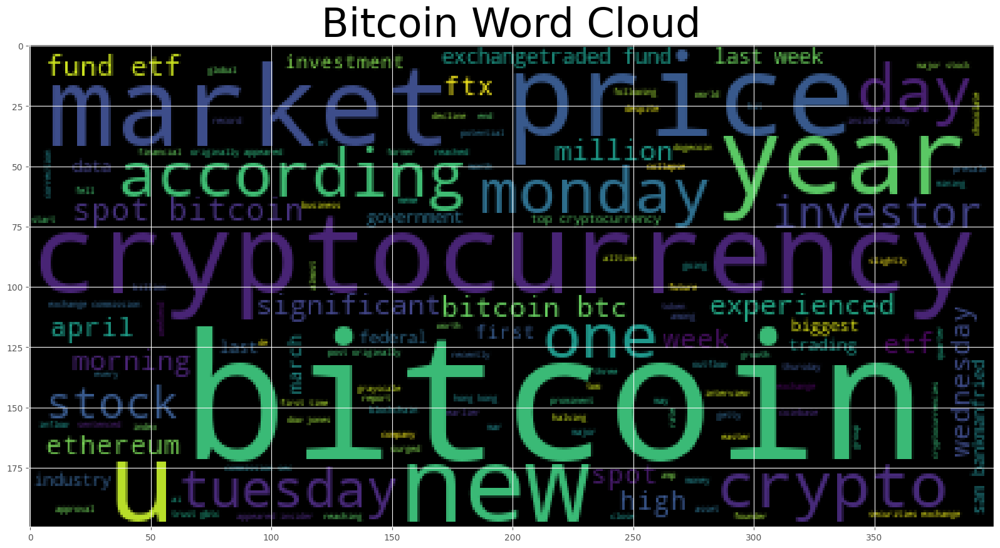

In [77]:
# Generate the Bitcoin word cloud
wc = WordCloud().generate(' '.join(btc_processed))
plt.imshow(wc)

# Add title to a Bitcoin Word Cloud 
plt.title("Bitcoin Word Cloud", fontdict={"fontsize":46})

Text(0.5, 1.0, 'Ethereum Word Cloud')

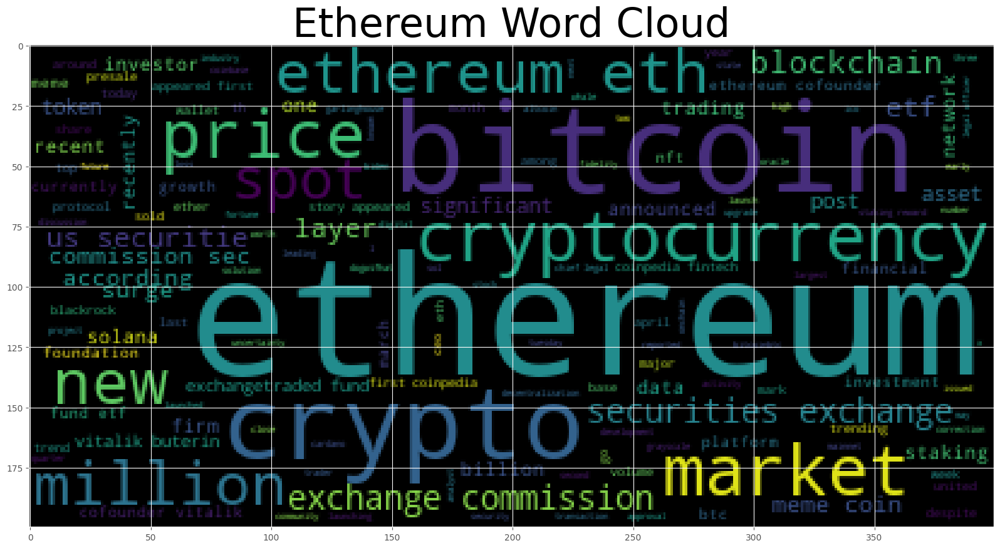

In [78]:
# Generate the Ethereum word cloud
wc = WordCloud().generate(" ".join(eth_processed))
plt.imshow(wc)

# Add title to a Ethereum Word Cloud 
plt.title("Ethereum Word Cloud", fontdict={"fontsize":46})

# Named Entity Recognition

In this section, you will build a named entity recognition model for both coins and visualize the tags using SpaCy.

In [79]:
import spacy
from spacy import displacy

In [80]:
# Load the spaCy model
nlp = spacy.load('en_core_web_sm')

## Bitcoin NER

In [81]:
# Concatenate all of the bitcoin text together
btc_joined = " ".join(btc_processed)

In [82]:
# Run the NER processor on all of the text
doc_btc = nlp(btc_joined)

# Add a title to the document
doc_btc.user_data["title"] = "Bitcoin NER"

In [83]:
# Render the visualization
displacy.render(doc_btc, style='ent')

In [84]:
# List all Entities
print([ent.text for ent in doc_btc.ents])

['march', 'washington', 'london', 'downaccordin us securities exchange commission', 'sec', 'wednesday', 'mar', 'year', 'million', 'monday two', 'monday', 'five consecutive day', 'late monday', 'cnbc', 'fourth financial quarter', 'october last year', 'month march', 'tuesday', 'mar', 'singleday', 'november', 'million', 'thursday', 'mar outflow come', 'million mark', 'tuesday', 'morning', 'april', 'single day', 'monday', 'morning', 'first', 'september', 'june', 'hong kong securities futures commission', 'sam bankmanfriedchelsea jia fenginsiderullithis', 'today', 'daily', 'last week', 'ether solana', 'colorado', 'hong kong', 'chinese', 'markus thielen', 'april', 'meme', 'mike schmidt', 'subpoena federal bureau', 'fbi', 'last year', 'april april', 'sec', 'three', 'london', 'jan van eck', 'sec', 'cftc', 'april', 'joe bidens', 'last week', 'weekend', 'one', 'meme', 'maximal european securities markets authority', 'rhysida ransomware', 'year', 'monday', 'last week', 'last week', 'int sam bankm

---

## Ethereum NER

In [85]:
# Concatenate all of the bitcoin text together
eth_joined = " ".join(eth_processed)

In [86]:
# Run the NER processor on all of the text
doc_eth = nlp(eth_joined)

# Add a title to the document
doc_eth.user_data["title"] = "Ethereum NER"

In [87]:
# Render the visualization
displacy.render(doc_eth, style='ent')

In [88]:
# List all Entities
print([ent.text for ent in doc_eth.ents])

['us securities exchange commission', 'sec', 'wednesday', 'steven nerayoff', 'anx solana', 'march', 'us securities exchange commission', 'sec', 'three', 'jan van eck', 'sec', 'hong kong', 'one million', 'million', 'million', 'around billion', 'pricesa', 'us securities exchange commission', 'sec', 'new york', 'billion', 'tuesday', 'morning', 'last week', 'weekend', 'one', 'meme', 'meme', 'april', 'three', 'solana', 'sunday night', 'second', 'new york', 'tuesday', 'mar', 'london', 'million', 'luis token', 'april', 'l united kingdom', 'july', 'markus thielen', 'april', 'tuesday', 'mar', 'singleday', 'november', 'joe bidens', 'year', 'million', 'monday two', 'abus', 'million', 'meme', 'giganti solana', 'interview cnbc', 'second', 'meme coin shiba', 'million', 'first quarter', 'april two week', 'european', 'first', 'us securities exchange commission', 'sec', 'fourth financial quarter', 'october last year', 'close month march', 'million mark', 'month', 'third', 'million mark', 'last month', 